In [2]:
!pip install docx

In [2]:
# Importing 
# Libraries
import plotly.io as pio
import seaborn as sns
sns.set_style('darkgrid')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from pdfminer.converter import TextConverter
from pdfminer.pdfinterp import PDFPageInterpreter
from pdfminer.pdfinterp import PDFResourceManager
from pdfminer.layout import LAParams
from pdfminer.pdfpage import PDFPage
import spacy
import io
from spacy.matcher import Matcher
import pandas as pd
import re
from nltk.corpus import stopwords
import constants as cs
import datetime
from datetime import datetime
from dateutil import relativedelta
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
nltk.download('stopwords')
import docx2txt
import subprocess
import docxpy
import shutil

import re
import time
import string
import warnings
from tqdm.notebook import tqdm_notebook
import os,re
import textract as tr

# for all NLP related operations on text 
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import *
from nltk.stem.porter import PorterStemmer
from wordcloud import WordCloud, STOPWORDS
from collections import Counter

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# To identify the sentiment of text
from textblob import TextBlob
from textblob.sentiments import NaiveBayesAnalyzer
from textblob.np_extractors import ConllExtractor

from sklearn.feature_extraction.text import CountVectorizer 
from nltk.tokenize import RegexpTokenizer

# ignoring all the warnings
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=DeprecationWarning)

[nltk_data] Downloading package stopwords to C:\Users\Moin
[nltk_data]     Dalvi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
file_path = r'C:/Users\Moin Dalvi\Documents\Data Science Material\Projects\Resume Classification\Resumes/'
doc_file = []
pdf_file = []
docx_file = []
folder_name = []
for folder in os.listdir(file_path):
    folder_path = file_path+folder
    for file in os.listdir(folder_path):
        if file.endswith('.doc'):
            doc_file.append(file)
            folder_name.append(folder)
        elif file.endswith('.docx'):
            docx_file.append(file)
            folder_name.append(folder)
        else:
            pdf_file.append(file)
            folder_name.append(folder)

In [3]:
print('Number of .doc files = {}'.format(len(doc_file)),'\n'
     'Number of .pdf files = {}'.format(len(pdf_file)),'\n'
     'Number of .docx files = {}'.format(len(docx_file)))

Number of .doc files = 26 
Number of .pdf files = 1 
Number of .docx files = 50


In [4]:
len(docx_file)+len(doc_file)+len(pdf_file)

77

In [5]:
['docx_file','doc_file','pdf_file']

['docx_file', 'doc_file', 'pdf_file']

In [6]:
%matplotlib inline

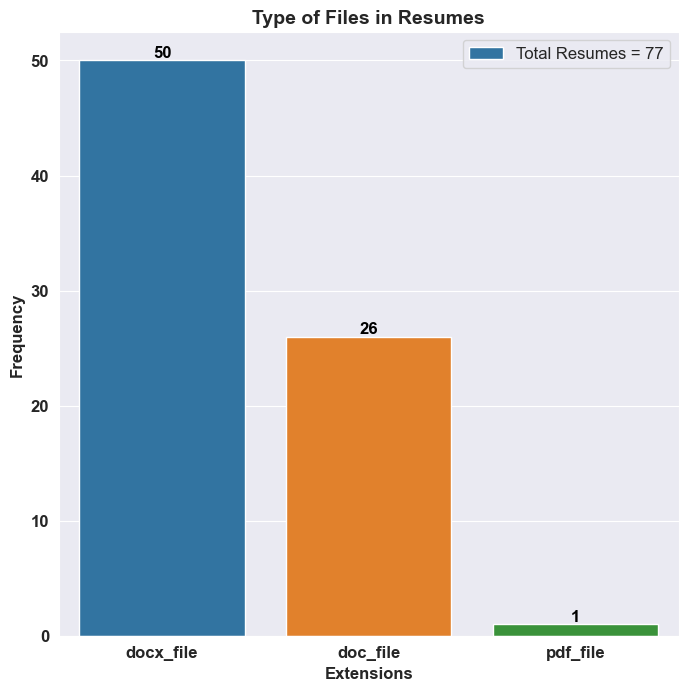

In [7]:
f, axe = plt.subplots(1,1, figsize=(8,8), dpi=100)
ax = sns.barplot(x=['docx_file','doc_file','pdf_file'], y=[len(docx_file),len(doc_file),len(pdf_file)], ax = axe
            ,label='Total Resumes = {}'.format(len(docx_file)+len(doc_file)+len(pdf_file)))
axe.set_xlabel('Extensions', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=12,fontweight = 'bold')
plt.xticks(fontsize=12,fontweight = 'bold')
plt.legend(loc='best', fontsize  = 'large')
plt.title('Type of Files in Resumes', fontsize = 14, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 12)
plt.show()

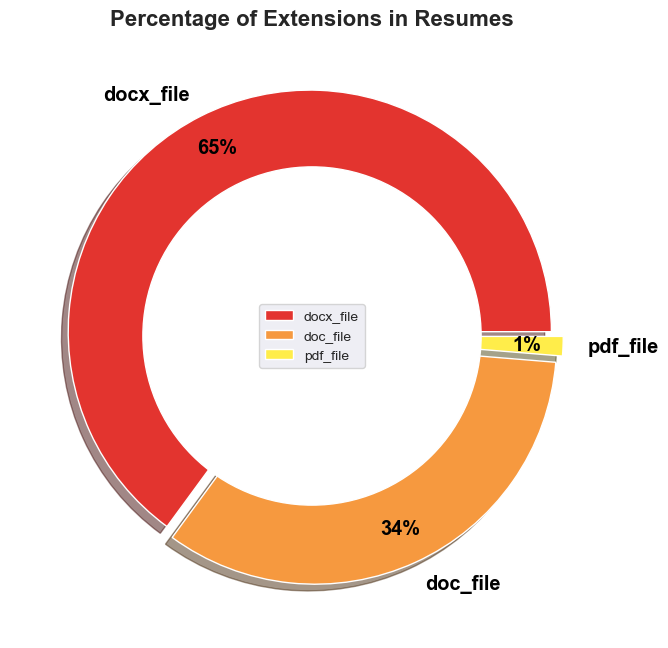

In [8]:
plt.figure(figsize=(12,8), dpi = 100)
# Setting size in Chart based on 
# given values

sizes = [len(docx_file),len(doc_file),len(pdf_file)]
  
# Setting labels for items in Chart
labels = ['docx_file','doc_file','pdf_file']
  
# colors
colors = ['#e3342f', '#f6993f', '#ffed4a']
  
# explosion
explode = (0.02, 0.03, 0.04)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%', shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'x-large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Percentage of Extensions in Resumes', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

In [2]:
file_path = r'C:/Users\Moin Dalvi\Data_Science\Projects\Resume_Classification\Resumes_docx/'
file_name = []
profile = []
for folder in os.listdir(file_path):
    folder_path = file_path+folder
    for file in os.listdir(folder_path):
        if file.endswith('.docx'):
            profile.append(folder)
            file_name.append(file)

In [3]:
data = pd.DataFrame()
data['Resumes'] = file_name
data['Profile'] = profile
data

,Resumes,Profile
0,Peoplesoft Admin_AnubhavSingh.docx,Peoplesoft
1,Peoplesoft Admin_Murali.docx,Peoplesoft
2,Peoplesoft Admin_SirazuddinMohammad.docx,Peoplesoft
3,Peoplesoft Admin_Varkala Vikas.docx,Peoplesoft
4,PeopleSoft DBA_Ganesh Alladi.docx,Peoplesoft
...,...,...
72,Sri Krishna S_Hexaware.docx,Workday
73,Srikanth-Hexaware.docx,Workday
74,SSKumar_Hexaware.docx,Workday
75,Venkateswarlu B_Hexaware.docx,Workday


In [15]:
data.Profile.value_counts().index

Index(['React Developer', 'Workday', 'Peoplesoft', 'SQL Developer'], dtype='object')

In [16]:
data.Profile.value_counts()

React Developer    22
Workday            21
Peoplesoft         20
SQL Developer      14
Name: Profile, dtype: int64

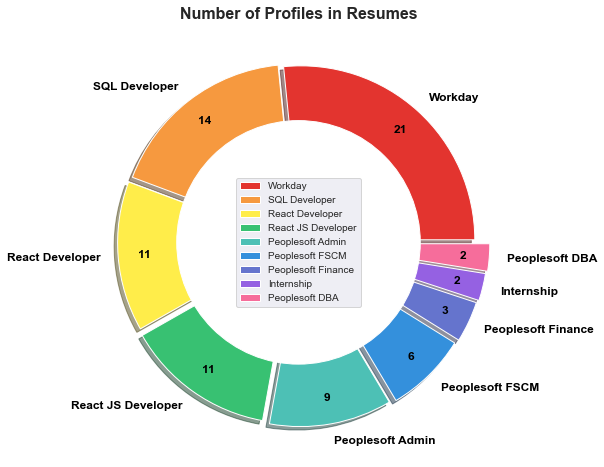

In [13]:
plt.figure(figsize=(12,8)) 
# Setting size in Chart based on 
# given values

sizes = data.Profile.value_counts()
  
# Setting labels for items in Chart
labels = data.Profile.value_counts().index
  
# colors
colors = ['#e3342f', '#f6993f', '#ffed4a', '#38c172', '#4dc0b5', '#3490dc', '#6574cd', '#9561e2', '#f66d9b' ]
  
# explosion
explode = (0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct=lambda x: '{:.0f}'.format(x*sizes.sum()/100), shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Number of Profiles in Resumes', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

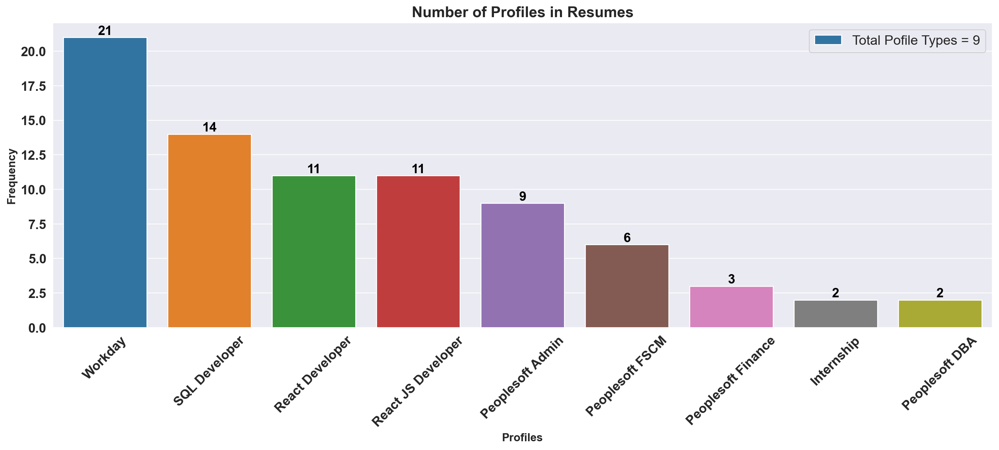

In [14]:
f, axe = plt.subplots(1,1, figsize=(18,6), dpi=200)
ax = sns.barplot(x=data.Profile.value_counts().index, y=data.Profile.value_counts(), data=data, ax = axe,
            label='Total Pofile Types = {}'.format(len(data.Profile.unique())))
axe.set_xlabel('Profiles', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=14,fontweight = 'bold')
plt.xticks(fontsize=14,fontweight = 'bold', rotation = 45)
plt.legend(loc='best', fontsize  = 'x-large')
plt.title('Number of Profiles in Resumes', fontsize = 16, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 14)
plt.show()

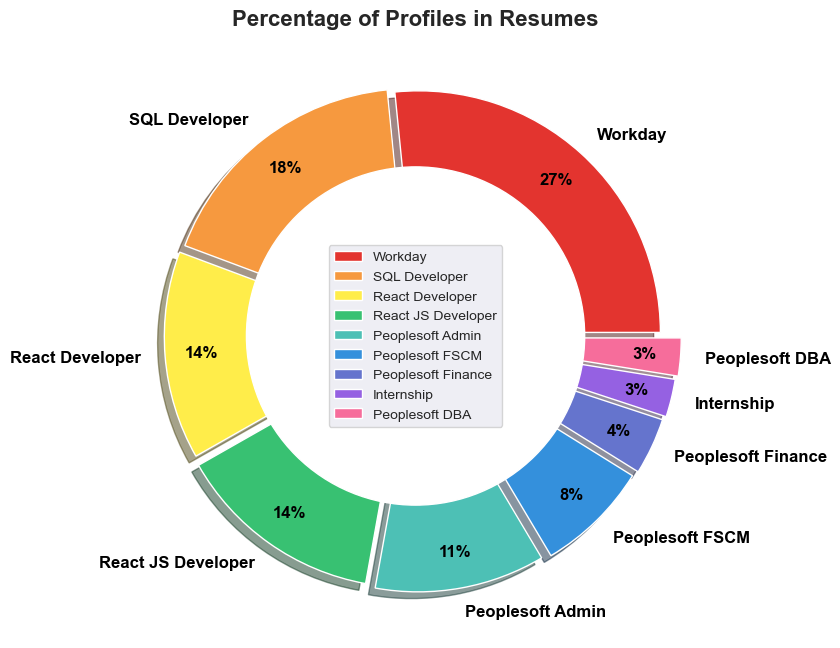

In [15]:
plt.figure(figsize=(12,8),dpi=100) 
# Setting size in Chart based on 
# given values

sizes = data.Profile.value_counts()
  
# Setting labels for items in Chart
labels = data.Profile.value_counts().index
  
# colors
colors = ['#e3342f', '#f6993f', '#ffed4a', '#38c172', '#4dc0b5', '#3490dc', '#6574cd', '#9561e2', '#f66d9b' ]
  
# explosion
explode = (0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%', shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Percentage of Profiles in Resumes', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

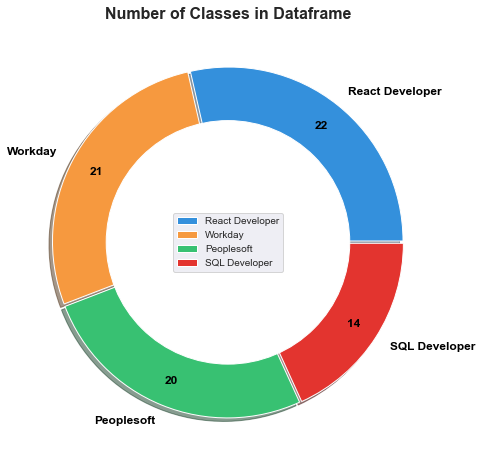

In [6]:
plt.figure(figsize=(12,8)) 
# Setting size in Chart based on 
# given values

sizes = data.Profile.value_counts()
  
# Setting labels for items in Chart
labels = data.Profile.value_counts().index
  
# colors
colors = ['#3490dc', '#f6993f','#38c172', '#e3342f']
  
# explosion
explode = (0.01, 0.01, 0.01, 0.01)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct=lambda x: '{:.0f}'.format(x*sizes.sum()/100), shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Number of Classes in Dataframe', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

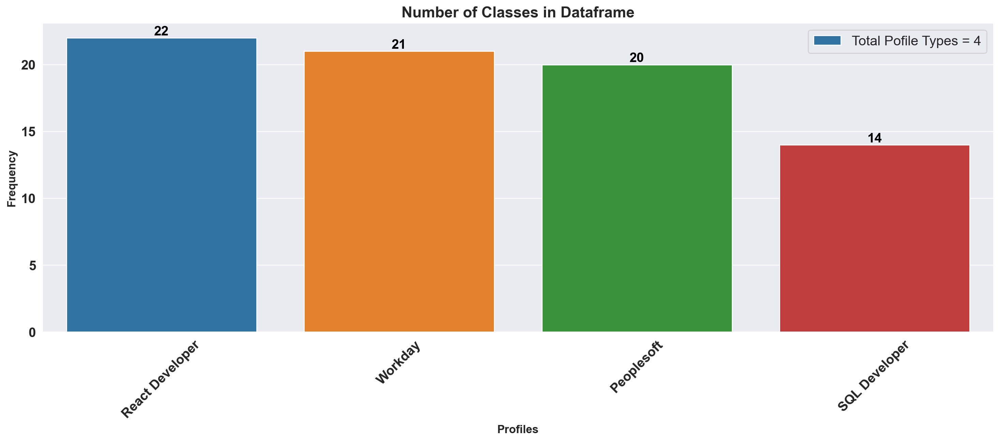

In [5]:
f, axe = plt.subplots(1,1, figsize=(18,6), dpi=200)
#colors = ['#e3342f', '#f6993f', '#3490dc', '#38c172']
ax = sns.barplot(x=data.Profile.value_counts().index, y=data.Profile.value_counts(), data=data, ax = axe,# color=colors,
            label='Total Pofile Types = {}'.format(len(data.Profile.unique())))
axe.set_xlabel('Profiles', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=14,fontweight = 'bold')
plt.xticks(fontsize=14,fontweight = 'bold', rotation = 45)
plt.legend(loc='best', fontsize  = 'x-large')
plt.title('Number of Classes in Dataframe', fontsize = 16, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 14)
plt.show()

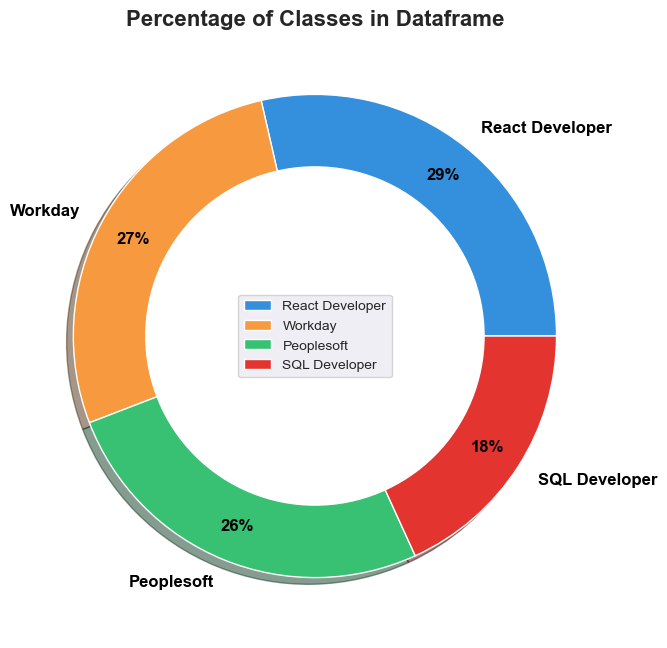

In [7]:
plt.figure(figsize=(12,8),dpi=100) 
# Setting size in Chart based on 
# given values

sizes = data.Profile.value_counts()
  
# Setting labels for items in Chart
labels = data.Profile.value_counts().index
  
# colors
colors = ['#3490dc', '#f6993f','#38c172', '#e3342f']
  
# explosion
explode = (0.0, 0.0, 0.0, 0.0)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%', shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Percentage of Classes in Dataframe', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="center")
  
# Displaying Chart

plt.show()

### Reading a Resume File

In [124]:
import docx2txt
 
def extract_text_from_docx(docx_path):
    txt = docx2txt.process(docx_path)
    if txt:
        return txt.replace('\t', ' ')
    return None
 
if __name__ == '__main__':
    print(extract_text_from_docx('C:/Users\Moin Dalvi\Documents\Data Science Material\Projects\Resume Classification\Resumes\React JS Developer/React JS Developer_KotaniDurgaprasad[3_1] (1)-converted.docx'))

Kotani Durga Prasad





Objective:



Aspirant for a position in an organization where I can contribute my skills for organization’s success and synchronize with new technologies while being resourceful, innovative and flexible.



Professional Summary:

 3.1 years of experience as a Software Engineer.

 Highly creative web designer and front end developer with experience of working on a diverse range of projects from small business websites to large scale websites with a global user base.

 Excellent knowledge in HTML, HTML5, CSS3, Bootstrap frameworks. Strong hands on experience in hand coding web technologies.

 Good Knowledge in Designing & Developing the Web pages based on SEO (Search Engine Optimization), W3C Standards and Cross-Browser Compatibility.

 Very good knowledge in client side programming with JavaScript, jQuery. Working knowledge in React JS.

 Experience in developing fully Responsive Websites using media queries and flexible layouts.

 Ability to create pixel to pi

In [4]:
df = pd.read_csv('Resume2Text_Extracted.csv')

In [5]:
df

,Resumes,Profiles
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft
1,Classification: Internal\n\nClassification: In...,Peoplesoft
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft
...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday


In [6]:
df[df.Profiles=='SQL Developer']

,Resumes,Profiles
42,ANIL KUMAR MADDUKURI \t\t\n\nSQL & MSBI Devel...,SQL Developer
43,Aradhana Tripathi\n\n\n\nCurrent Location: Gac...,SQL Developer
44,BUDDHA VAMSI ...,SQL Developer
45,KAMBALLA PRADEEP ...,SQL Developer
46, Hyderabad\n\n\nNazeer Basha\n\nSQL and Power...,SQL Developer
47,Resume\n\nName : Neeraj Mishra\n\n\n\nExp...,SQL Developer
48,SQL DEVELOPER\n\nName: - Bandi prem sai\n\n\...,SQL Developer
49,SQL SERVER DEVELOPER\n\n\n\n\n\nPriyanka L ...,SQL Developer
50,SQL SERVER DEVELOPER\n\n\n\n\n\nP. Syam Kumar ...,SQL Developer
51,RAJU PAVANA KUMARI\n\n\n\n\t\n\n\tProfessional...,SQL Developer


## <a id='2'>Data Exploration</a>

In [15]:
df[df.duplicated()].shape

(0, 2)

In [16]:
df[df.duplicated()]

,Resumes,Profiles


In [17]:
df.isnull().any()

Resumes     False
Profiles    False
dtype: bool

In [18]:
df.isnull().sum()

Resumes     0
Profiles    0
dtype: int64

#### Number of Words

In [19]:
df['word_count'] = df['Resumes'].apply(lambda x: len(str(x).split(" ")))
df[['Resumes','word_count']].head()

,Resumes,word_count
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,1023
1,Classification: Internal\n\nClassification: In...,558
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",455
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,918
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,1641


In [20]:
%matplotlib inline

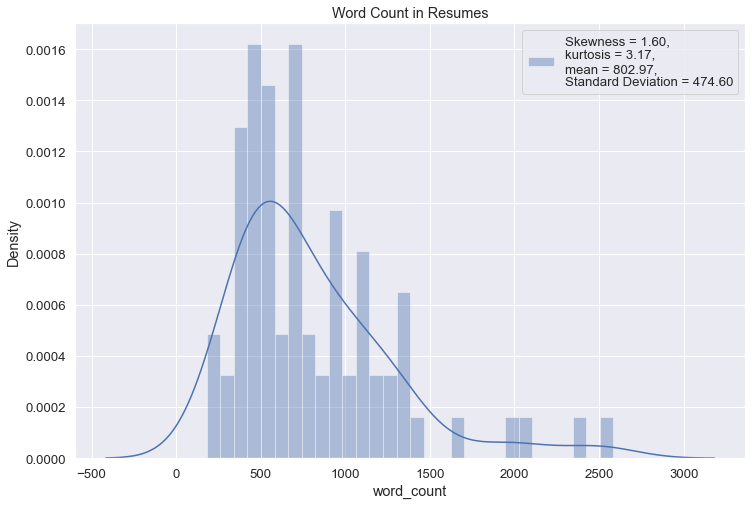

In [21]:
skew = df['word_count'].skew()
kurt = df['word_count'].kurt()
mean = df['word_count'].mean()
std = df['word_count'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["word_count"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Word Count in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of characters

In [22]:
df['char_count'] = df['Resumes'].str.len() ## this also includes spaces
df[['Resumes','char_count']].head()

,Resumes,char_count
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,8010
1,Classification: Internal\n\nClassification: In...,4917
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",3800
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,7943
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,11121


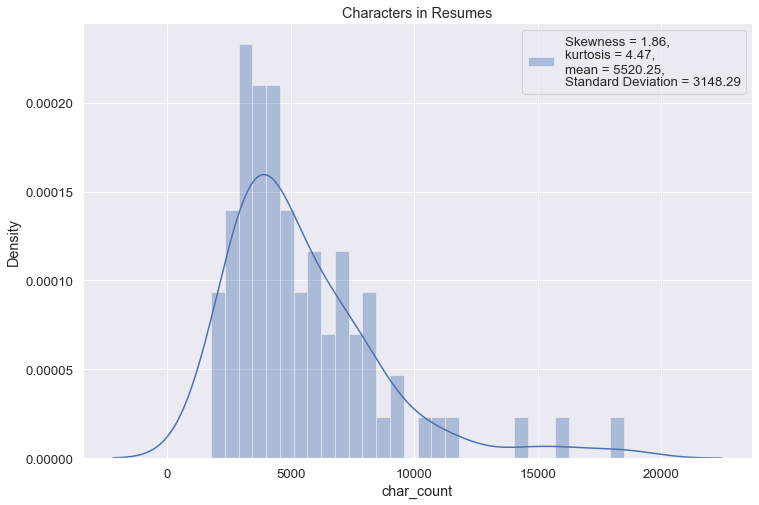

In [45]:
skew = df['char_count'].skew()
kurt = df['char_count'].kurt()
mean = df['char_count'].mean()
std = df['char_count'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["char_count"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Characters in Resumes')
plt.legend(loc='best')
plt.show()

#### Average Word Length in each Resumes

In [23]:
def avg_word(sentence):
    words = sentence.split()
    return (sum(len(word) for word in words)/len(words))

df['avg_word'] = df['Resumes'].apply(lambda x: avg_word(x))
df[['Resumes','avg_word']].head()

,Resumes,avg_word
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,6.415929
1,Classification: Internal\n\nClassification: In...,6.317817
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",6.109162
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,6.575787
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,6.429279


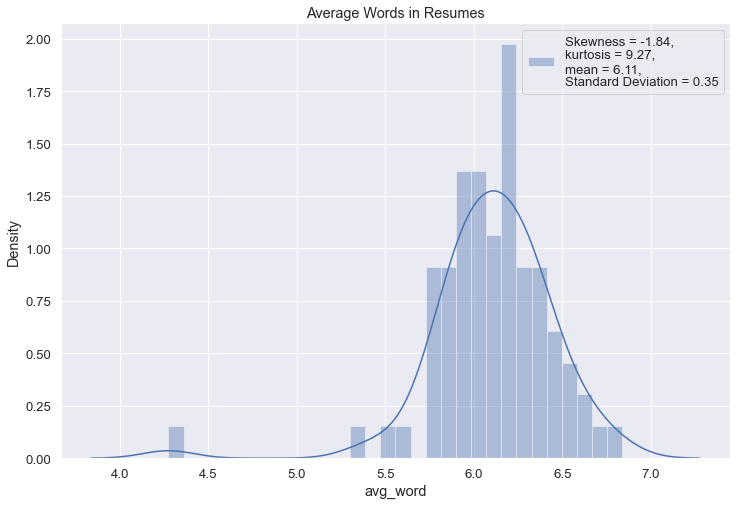

In [49]:
skew = df['avg_word'].skew()
kurt = df['avg_word'].kurt()
mean = df['avg_word'].mean()
std = df['avg_word'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["avg_word"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Average Words in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of stopwords

In [24]:
from nltk.corpus import stopwords
stop = stopwords.words('english')

df['stopwords'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x in stop]))
df[['Resumes','stopwords']].head()

,Resumes,stopwords
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,190
1,Classification: Internal\n\nClassification: In...,114
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",86
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,225
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,303


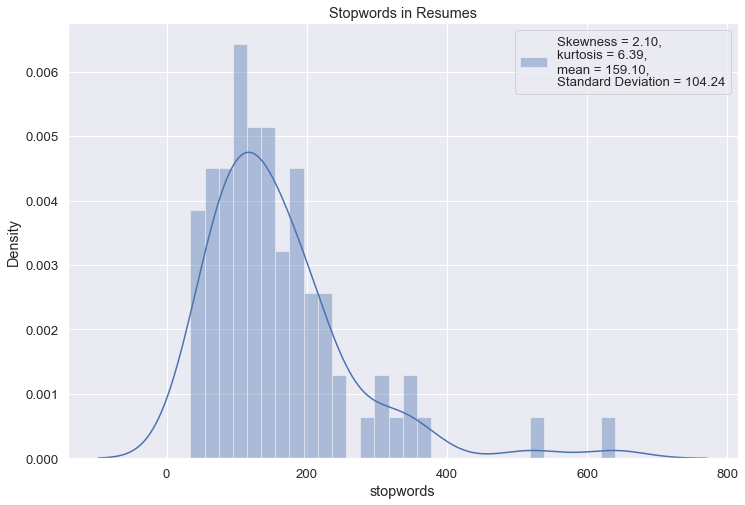

In [51]:
skew = df['stopwords'].skew()
kurt = df['stopwords'].kurt()
mean = df['stopwords'].mean()
std = df['stopwords'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["stopwords"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Stopwords in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of numerics

In [25]:
df['numerics'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x.isdigit()]))
df[['Resumes','numerics']].head()

,Resumes,numerics
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,4
1,Classification: Internal\n\nClassification: In...,7
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",15
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,4
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,16


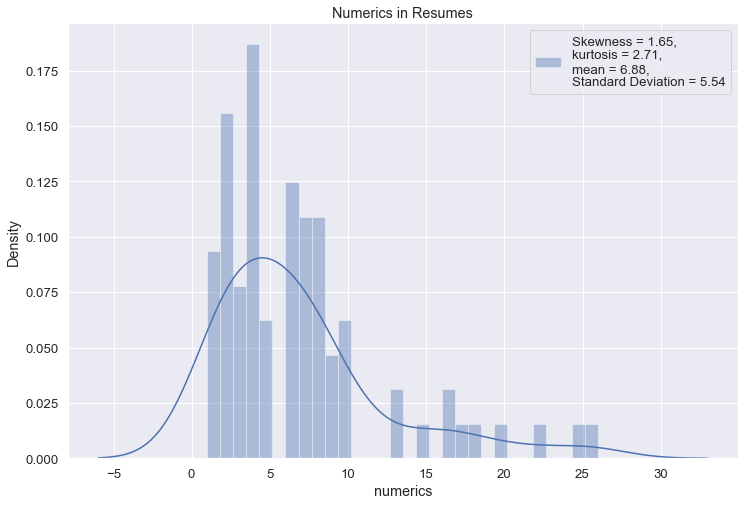

In [53]:
skew = df['numerics'].skew()
kurt = df['numerics'].kurt()
mean = df['numerics'].mean()
std = df['numerics'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["numerics"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Numerics in Resumes')
plt.legend(loc='best')
plt.show()

#### Number of Uppercase words

In [26]:
df['uppercase'] = df['Resumes'].apply(lambda x: len([x for x in x.split() if x.isupper()]))
df[['Resumes','uppercase']].head()

,Resumes,uppercase
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,60
1,Classification: Internal\n\nClassification: In...,53
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",77
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,58
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,85


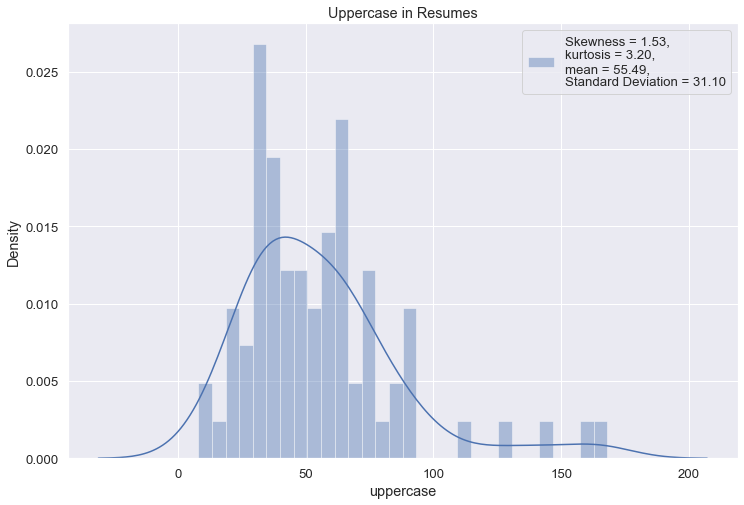

In [55]:
skew = df['uppercase'].skew()
kurt = df['uppercase'].kurt()
mean = df['uppercase'].mean()
std = df['uppercase'].std()
plt.figure(figsize=(12,8))
sns.set(font_scale=1.2)
sns.distplot(df["uppercase"], kde= True, label='Skewness = {:.2f},\nkurtosis = {:.2f},\nmean = {:.2f},\nStandard Deviation = {:.2f}'.format(skew, kurt, mean, std), bins=30).set(title='Uppercase in Resumes')
plt.legend(loc='best')
plt.show()

In [27]:
df.to_csv('Counts_extracted.csv', index=False)
df = pd.read_csv('Counts_extracted.csv')
df

,Resumes,Profiles,word_count,char_count,avg_word,stopwords,numerics,uppercase
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft,1023,8010,6.415929,190,4,60
1,Classification: Internal\n\nClassification: In...,Peoplesoft,558,4917,6.317817,114,7,53
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft,455,3800,6.109162,86,15,77
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft,918,7943,6.575787,225,4,58
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft,1641,11121,6.429279,303,16,85
...,...,...,...,...,...,...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday,904,7030,6.442391,197,3,57
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday,1063,6737,5.995570,194,9,85
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday,1076,8329,6.030810,236,6,69
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday,1031,6836,6.272418,193,7,46


#### Percentage of Links attached in the Resumes

In [28]:
(df.Resumes.str.contains('https://').value_counts() / len(df))*100

False    90.909091
True      9.090909
Name: Resumes, dtype: float64

In [58]:
links = (df.Resumes.str.contains('https://').value_counts() / len(df))*100
No_links = links[0]
Yes_links = links[1]

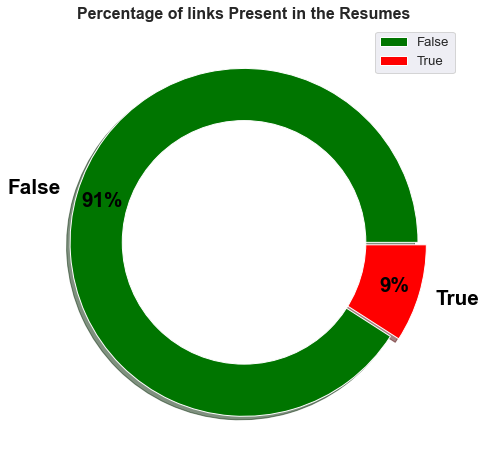

In [59]:
plt.figure(figsize=(12,8)) 
# Setting size in Chart based on 
# given values

sizes = [No_links, Yes_links]
  
# Setting labels for items in Chart
labels = ['False', 'True']
  
# colors
colors = ['#007500', '#FF0000']
  
# explosion
explode = (0.0, 0.05)
  
# Pie Chart
plt.pie(sizes, colors=colors, labels=labels,
        autopct='%1.0f%%', shadow=True,
        pctdistance=0.85, 
        explode=explode,
        startangle=0,
        textprops = {'size':'x-large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
  
# draw circle
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig = plt.gcf()
  
# Adding Circle in Pie chart
fig.gca().add_artist(centre_circle)

# Adding Title of chart
plt.title('Percentage of Hyperlinks Present in the Resumes', fontsize = 16, fontweight = 'bold')
  
# Add Legends
plt.legend(labels, loc="upper right")
  
# Displaying Chart
plt.show()

### Text Pre-Processing

#### <a id='5Af'>Removing Punctuations, Numbers and Special characters</a>
This step should not be followed if we also want to do sentiment analysis on __key phrases__ as well, because semantic meaning in a sentence needs to be present. So here we will create one additional column 'absolute_tidy_tweets' which will contain absolute tidy words which can be further used for sentiment analysis on __key words__.

<a id='5Ah'>h. Removing Stop words</a>
With the same reason we mentioned above, we won't perform this on 'tidy_tweets' column, because it needs to be used for __key_phrases__ sentiment analysis.

#### <a id='5Ai'> Tokenize *'Resumes'*</a>  

#### <a id='5Aj'> Converting words to Lemma</a>

In [29]:
import re
import string
import nltk
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer,PorterStemmer
from nltk.corpus import stopwords
lemmatizer = WordNetLemmatizer()
stemmer = PorterStemmer() 
nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package wordnet to C:\Users\Moin
[nltk_data]     Dalvi\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Moin
[nltk_data]     Dalvi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [30]:
def preprocess(sentence):
    sentence=str(sentence)
    sentence = sentence.lower()
    sentence=sentence.replace('{html}',"") 
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, '', sentence)
    rem_url=re.sub(r'http\S+', '',cleantext)
    rem_num = re.sub('[0-9]+', '', rem_url)
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(rem_num)  
    filtered_words = [w for w in tokens if len(w) > 2 if not w in stopwords.words('english')]
    stem_words=[stemmer.stem(w) for w in filtered_words]
    lemma_words=[lemmatizer.lemmatize(w) for w in stem_words]
    return " ".join(filtered_words)

In [31]:
df = pd.read_csv('Resume2Text_Extracted.csv')
df['Clean_Resumes']=df.Resumes.apply(lambda x: preprocess(x))
df.to_csv('Cleaned_Resumes.csv', index = False)

In [3]:
df = pd.read_csv('Cleaned_Resumes.csv')
df

,Resumes,Profiles,Clean_Resumes
0,Anubhav Kumar Singh\t\t\n\n\n\nCore Competenci...,Peoplesoft,anubhav kumar singh core competencies scriptin...
1,Classification: Internal\n\nClassification: In...,Peoplesoft,classification internal classification interna...
2,"SIRAZUDDIN M\n\n\tBangalore, INDIA\t\n\n\n\n\n...",Peoplesoft,sirazuddin bangalore india sirazuddin bangalor...
3,PeopleSoft Admin\n\nVARKALA VIKAS\n\n\n\nCaree...,Peoplesoft,peoplesoft admin varkala vikas career objectiv...
4,PeopleSoft Admin/PeopleSoft DBA\n\n\n\nGanesh ...,Peoplesoft,peoplesoft admin peoplesoft dba ganesh alladi ...
...,...,...,...
72,Workday Integration Consultant\n\n\n\nName ...,Workday,workday integration consultant name sri krishn...
73,Srikanth (WORKDAY hCM Consultant)\t ...,Workday,srikanth workday hcm consultant seeking suitab...
74,WORKDAY | HCM | FCM\n\nName \t\t: Kumar S.S\n\...,Workday,workday hcm fcm name kumar role workday consul...
75,Venkateswarlu.B\t\t\t\t\t\t\t\tWorkday Consult...,Workday,venkateswarlu workday consultant professional ...


In [33]:
df.Resumes[20]

'Kanumuru Deepak Reddy\n\n\n\n\t\n\n\n\nCAREER OBJECTIVE:\n\n\n\nTo secure a position in a reputed organization where I can efficiently contribute my knowledge and skills to the growth of the organization and build my professional career.\n\n\n\nACADEMIC QUALIFICATIONS:\n\n\n\n\n\nQualification\n\nInstitute\n\nBoard (or) University\n\nYear of completion\n\nPercentage/CGPA\n\nB.Tech (E.C.E)\n\nAudisankara College of Engineering & Technology,Gudur.\n\nJNTU Anantapur.\n\n2018\n\n77.3\n\nIntermediate\n\nNarayana Junior college, Naidupet.\n\nBoard of\n\nIntermediate, AP.\n\n2014\n\n89.5\n\nSSC\n\nNavodaya High School,Naidupet\n\nBoard of Secondary education, AP.\n\n2012\n\n6.7\n\n\n\nPROJECT:\n\n\n\nTitle\t:Density based Traffic Control System USING ARDUINO.\n\n\n\nDuration:4 months.\n\n\n\nDescription: Traffic congestion is a severe problem in most of the cities across the world and it has become a nightmare for the citizens. It is caused by delay in signal, inappropriate timing of traffic

In [34]:
df.Clean_Resumes[20]

'kanumuru deepak reddy career objective secure position reputed organization efficiently contribute knowledge skills growth organization build professional career academic qualifications qualification institute board university year completion percentage cgpa tech audisankara college engineering technology gudur jntu anantapur intermediate narayana junior college naidupet board intermediate ssc navodaya high school naidupet board secondary education project title density based traffic control system using arduino duration months description traffic congestion severe problem cities across world become nightmare citizens caused delay signal inappropriate timing traffic signalling etc delay traffic light hard coded depend traffic therefore optimising traffic control increasing demand systematic quick automatic system project designed develop density based dynamic traffic signal control signal timing changes automatically sensing traffic density junction microcontroller used project arduin

### Data Exploration

Now its time to explore the preprocessed and cleaned text reviews. Textual data can be explored using Word Clouds. These are visual representations of the frequency of different words present in text. Importance of words are represented by size of the word. Bigger size represents more frequently occuring words.$

### N-grams
N-grams are the combination of multiple words used together. Ngrams with N=1 are called unigrams. Similarly, bigrams (N=2), trigrams (N=3) and so on can also be used.

Unigrams do not usually contain as much information as compared to bigrams and trigrams. The basic principle behind n-grams is that they capture the language structure, like what letter or word is likely to follow the given one. The longer the n-gram (the higher the n), the more context you have to work with. Optimum length really depends on the application – if your n-grams are too short, you may fail to capture important differences. On the other hand, if they are too long, you may fail to capture the “general knowledge” and only stick to particular cases.

So, let’s quickly extract bigrams from our tweets using the ngrams function of the textblob library.

In [37]:
TextBlob(df['Resumes'][1]).ngrams(1)[:20]

[WordList(['SUSOVAN']),
 WordList(['BAG']),
 WordList(['Seeking']),
 WordList(['a']),
 WordList(['challenging']),
 WordList(['position']),
 WordList(['in']),
 WordList(['the']),
 WordList(['field']),
 WordList(['of']),
 WordList(['science']),
 WordList(['and']),
 WordList(['technology']),
 WordList(['to']),
 WordList(['utilize']),
 WordList(['my']),
 WordList(['skills']),
 WordList(['for']),
 WordList(['organization']),
 WordList(['and'])]

In [38]:
TextBlob(df['Resumes'][1]).ngrams(2)[:20]

[WordList(['SUSOVAN', 'BAG']),
 WordList(['BAG', 'Seeking']),
 WordList(['Seeking', 'a']),
 WordList(['a', 'challenging']),
 WordList(['challenging', 'position']),
 WordList(['position', 'in']),
 WordList(['in', 'the']),
 WordList(['the', 'field']),
 WordList(['field', 'of']),
 WordList(['of', 'science']),
 WordList(['science', 'and']),
 WordList(['and', 'technology']),
 WordList(['technology', 'to']),
 WordList(['to', 'utilize']),
 WordList(['utilize', 'my']),
 WordList(['my', 'skills']),
 WordList(['skills', 'for']),
 WordList(['for', 'organization']),
 WordList(['organization', 'and']),
 WordList(['and', 'individual'])]

In [39]:
TextBlob(df['Resumes'][1]).ngrams(3)[:20]

[WordList(['SUSOVAN', 'BAG', 'Seeking']),
 WordList(['BAG', 'Seeking', 'a']),
 WordList(['Seeking', 'a', 'challenging']),
 WordList(['a', 'challenging', 'position']),
 WordList(['challenging', 'position', 'in']),
 WordList(['position', 'in', 'the']),
 WordList(['in', 'the', 'field']),
 WordList(['the', 'field', 'of']),
 WordList(['field', 'of', 'science']),
 WordList(['of', 'science', 'and']),
 WordList(['science', 'and', 'technology']),
 WordList(['and', 'technology', 'to']),
 WordList(['technology', 'to', 'utilize']),
 WordList(['to', 'utilize', 'my']),
 WordList(['utilize', 'my', 'skills']),
 WordList(['my', 'skills', 'for']),
 WordList(['skills', 'for', 'organization']),
 WordList(['for', 'organization', 'and']),
 WordList(['organization', 'and', 'individual']),
 WordList(['and', 'individual', 'growth'])]

In [65]:
df['Clean_Resumes']

0     name ravali curriculum vitae specialization co...
1     susovan bag seeking challenging position field...
2     anubhav kumar singh work globally competitive ...
3     ananda rayudu profile summary years experience...
4     peoplesoft database administrator gangareddy p...
                            ...                        
74    workday integration consultant name sri krishn...
75    seeking suitable positions workday hcm techno ...
76    workday hcm fcm name role kumar workday consul...
77    venkateswarlu workday consultant professional ...
78    vinay kumar workday functional consultant expe...
Name: Clean_Resumes, Length: 79, dtype: object

In [165]:
from sklearn.feature_extraction.text import CountVectorizer
c_vec = CountVectorizer(stop_words=stopwords.words('english'), ngram_range=(1,2))
# matrix of ngrams
ngrams = c_vec.fit_transform(df['Clean_Resumes'])
# count frequency of ngrams
count_values = ngrams.toarray().sum(axis=0)
# list of ngrams
vocab = c_vec.vocabulary_
df_ngram = pd.DataFrame(sorted([(count_values[i],k) for k,i in vocab.items()], reverse=True)
            ).rename(columns={0: 'frequency', 1:'unigram/bigram'})

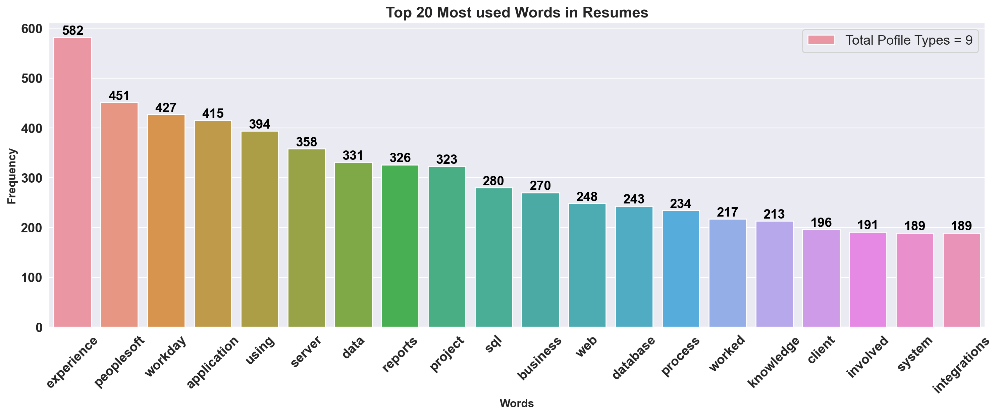

In [167]:
f, axe = plt.subplots(1,1, figsize=(18,6), dpi=200)
ax = sns.barplot(x=df_ngram['unigram/bigram'].head(20), y=df_ngram.frequency.head(20), data=data, ax = axe,
            label='Total Pofile Types = {}'.format(len(data.Profile.unique())))
axe.set_xlabel('Words', size=12,fontweight = 'bold')
axe.set_ylabel('Frequency', size=12,fontweight = 'bold')
plt.yticks(fontsize=14,fontweight = 'bold')
plt.xticks(fontsize=14,fontweight = 'bold', rotation = 45)
plt.legend(loc='best', fontsize  = 'x-large')
plt.title('Top 20 Most used Words in Resumes', fontsize = 16, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 14)
plt.show()

### Generate Word Cloud

In [61]:
oneSetOfStopWords = set(stopwords.words('english')+['``',"''"])
totalWords =[]
Sentences = df['Clean_Resumes'].values
cleanedSentences = ""
for records in Sentences:
    cleanedText = preprocess(records)
    cleanedSentences += cleanedText
    requiredWords = nltk.word_tokenize(cleanedText)
    for word in requiredWords:
        if word not in oneSetOfStopWords and word not in string.punctuation:
            totalWords.append(word)
    
wordfreqdist = nltk.FreqDist(totalWords)
mostcommon = wordfreqdist.most_common(50)
print(mostcommon)

[('experience', 582), ('peoplesoft', 451), ('workday', 427), ('application', 415), ('using', 394), ('server', 358), ('data', 331), ('reports', 326), ('project', 323), ('sql', 280), ('business', 270), ('web', 248), ('database', 243), ('process', 234), ('worked', 217), ('knowledge', 213), ('client', 196), ('involved', 191), ('system', 189), ('integrations', 189), ('tools', 188), ('integration', 183), ('hcm', 180), ('like', 178), ('support', 177), ('good', 166), ('skills', 164), ('creating', 164), ('development', 164), ('team', 162), ('working', 158), ('people', 157), ('technical', 156), ('report', 155), ('services', 155), ('design', 154), ('servers', 151), ('created', 150), ('testing', 146), ('various', 146), ('responsibilities', 145), ('react', 145), ('role', 142), ('oracle', 140), ('environment', 139), ('developer', 135), ('management', 134), ('eib', 134), ('security', 133), ('production', 133)]


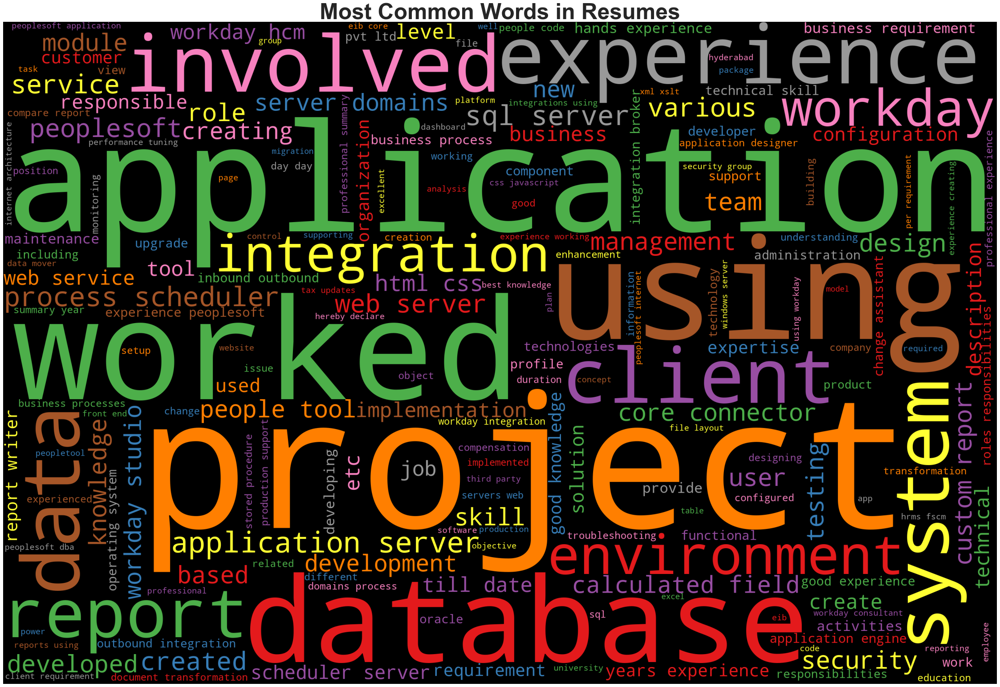

In [62]:
from wordcloud import WordCloud
# Define a function to plot word cloud
def plot_cloud(wordcloud):
    plt.figure(figsize=(40,30))
    plt.imshow(wordcloud)
    plt.title('Most Common Words in Resumes', fontsize = 50, fontweight = 'bold')
    plt.axis('off')
    plt.show()
    
# Generate Word Cloud

#STOPWORDS.add('pron')
#STOPWORDS.add('rt')
#STOPWORDS.add('yeah')
wordcloud=WordCloud(width=3000,height=2000,background_color='black',max_words=200,
                   colormap='Set1').generate(cleanedSentences)

plot_cloud(wordcloud)

### <a id='9'> Story Generation and Visualization</a>

#### <a id='9A'>A. Most common words in Different Profile Resumes</a>
Answer can be best found using WordCloud

In [21]:
def generate_wordcloud(all_words, Profile):
    wordcloud = WordCloud(width=800, height=500,background_color='black',max_words=200,
                   colormap='Set1').generate(all_words)

    plt.figure(figsize=(14, 10), dpi=200)
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title('Most Common Words in {} Resumes'.format(Profile), fontsize = 16, fontweight = 'bold')
    plt.show()

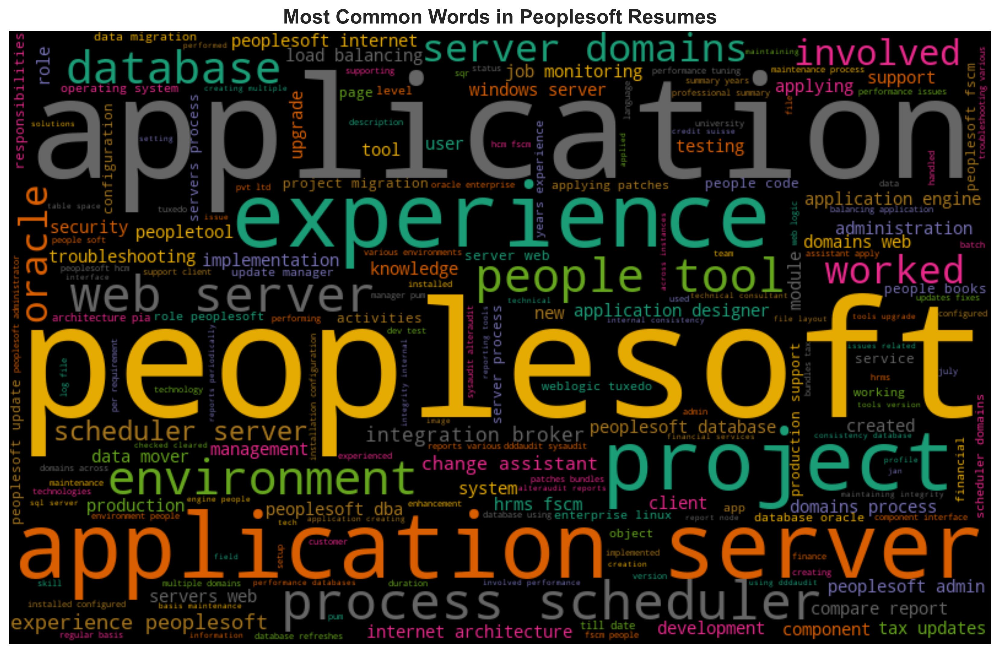

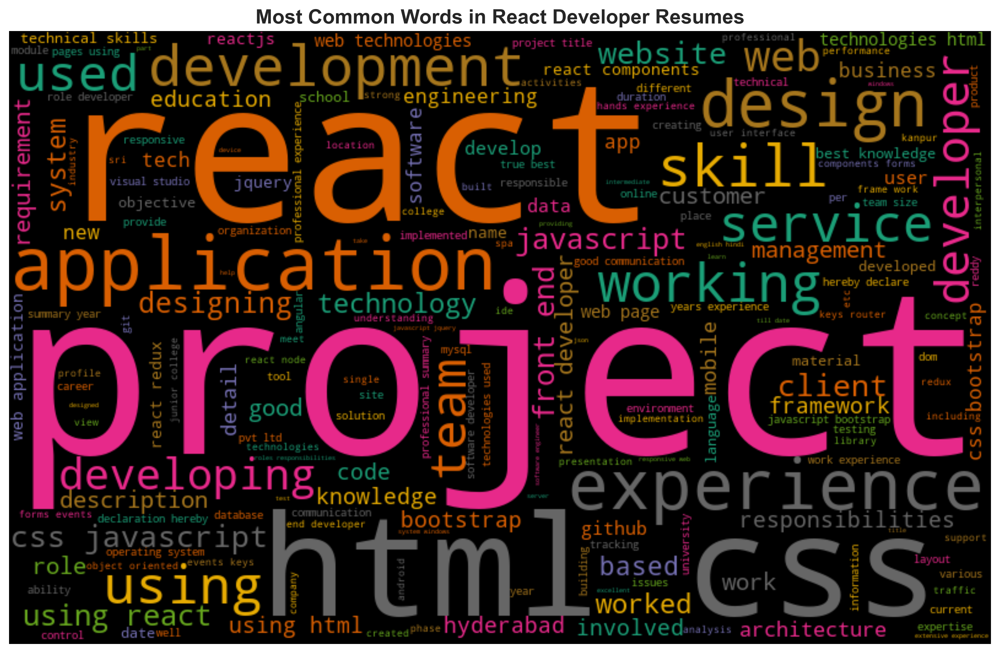

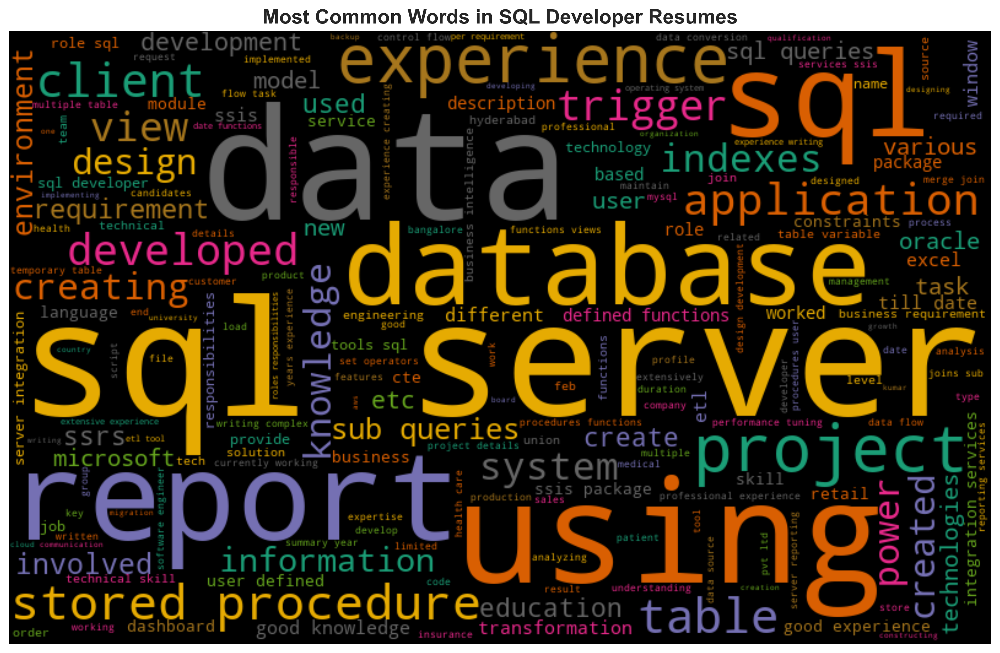

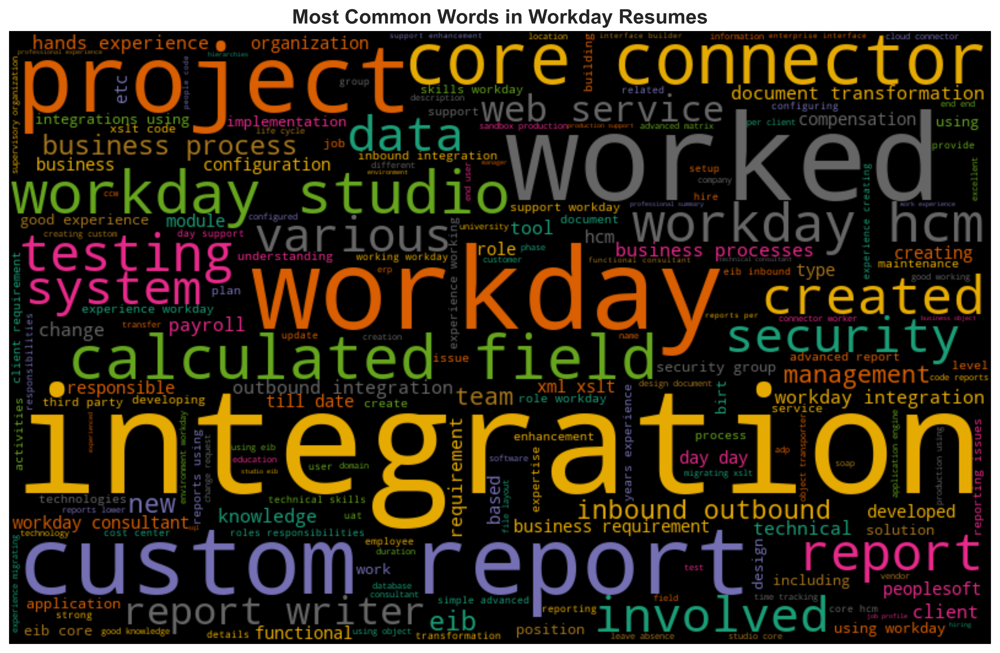

In [68]:
for profiles in df.Profiles.unique():
    all_words = ' '.join([text for text in df['Clean_Resumes'][df.Profiles == profiles]])
    generate_wordcloud(all_words, profiles)

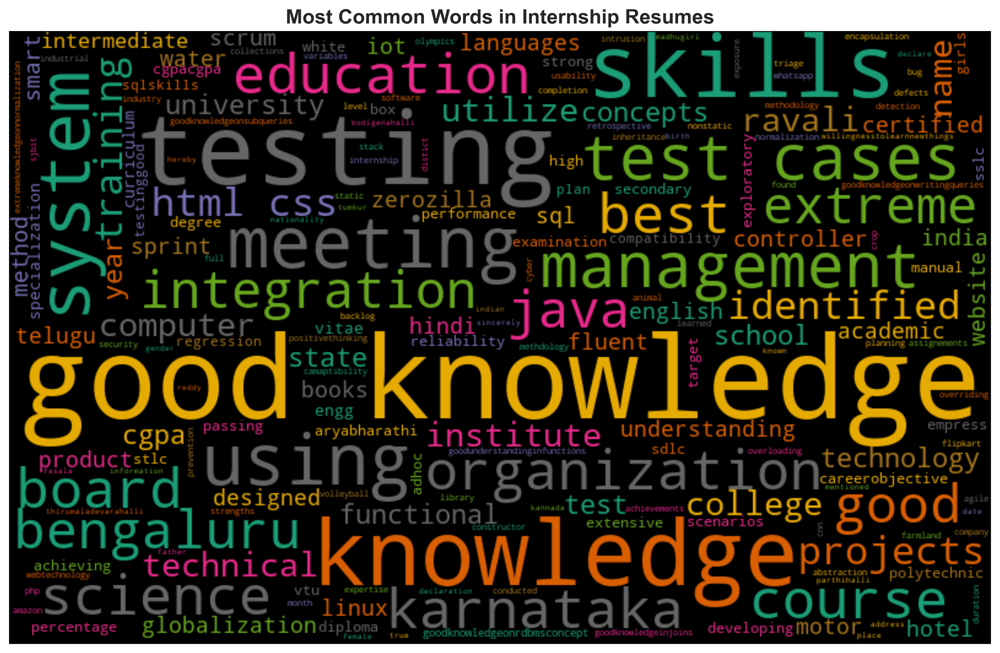

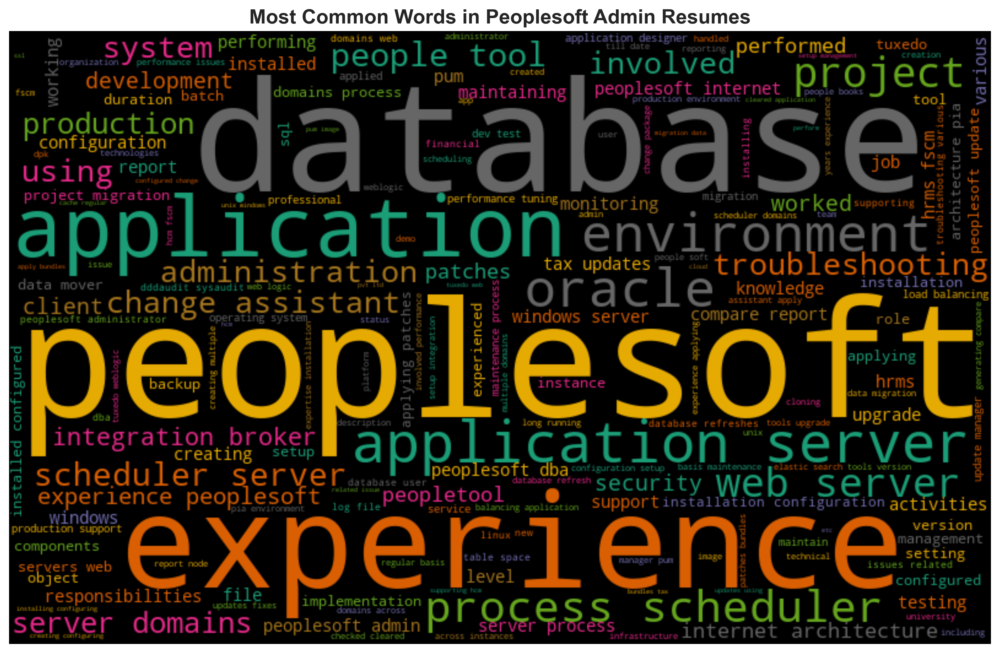

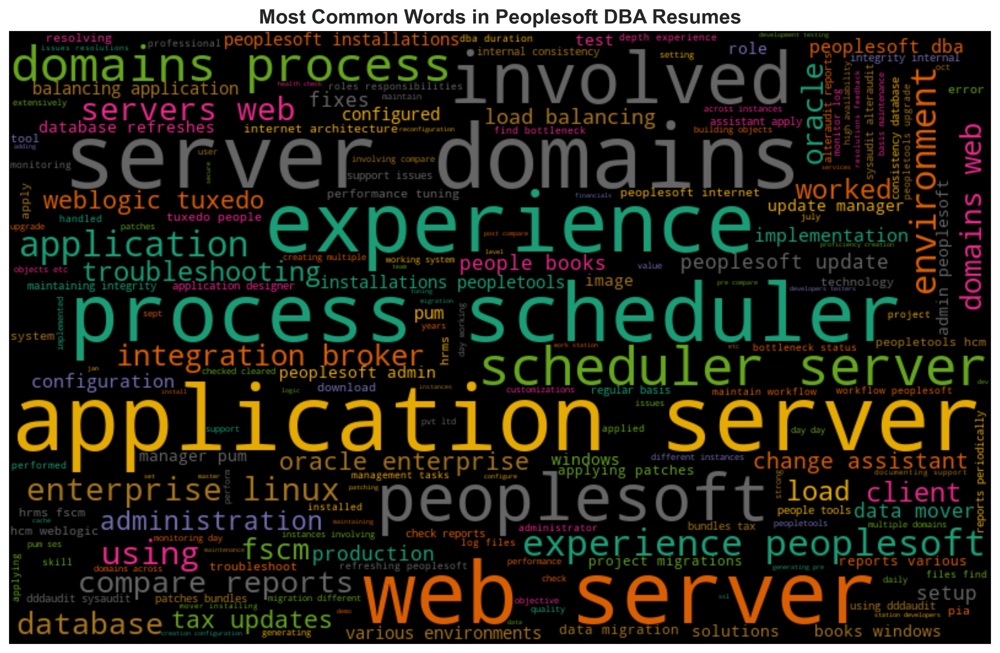

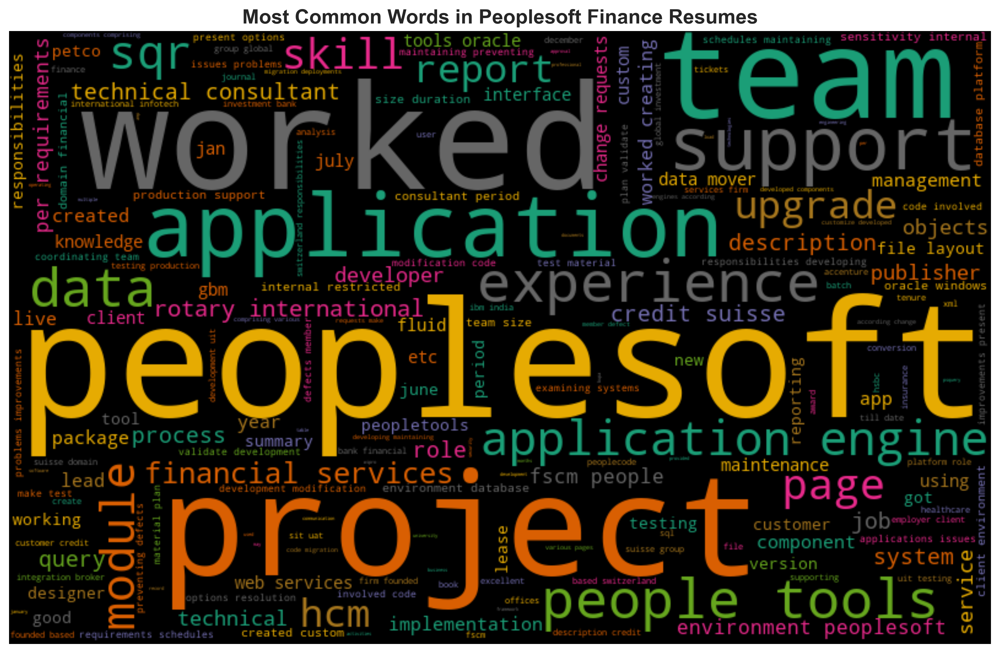

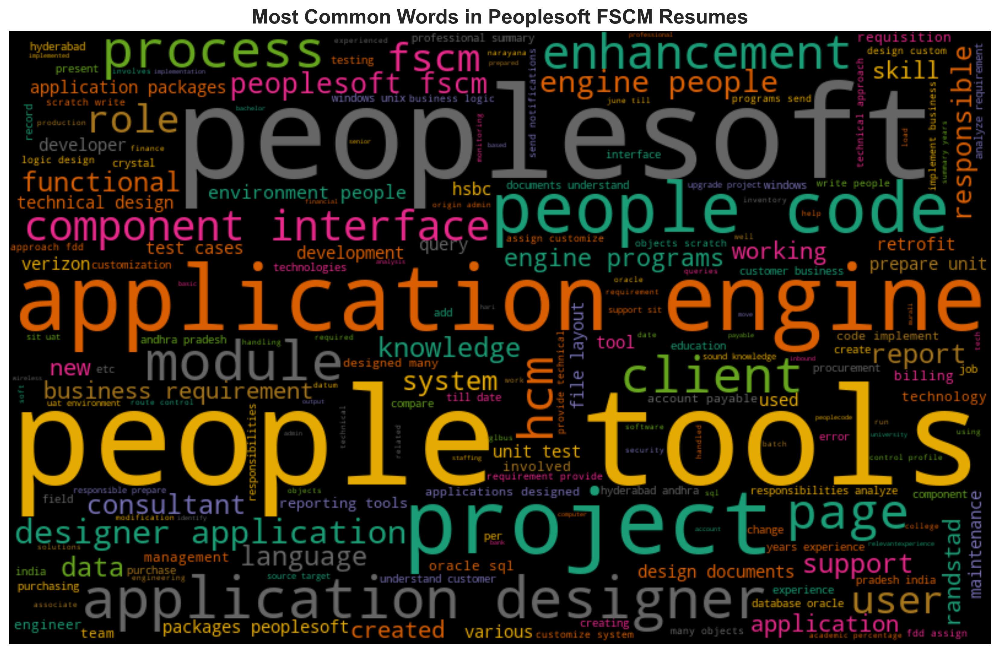

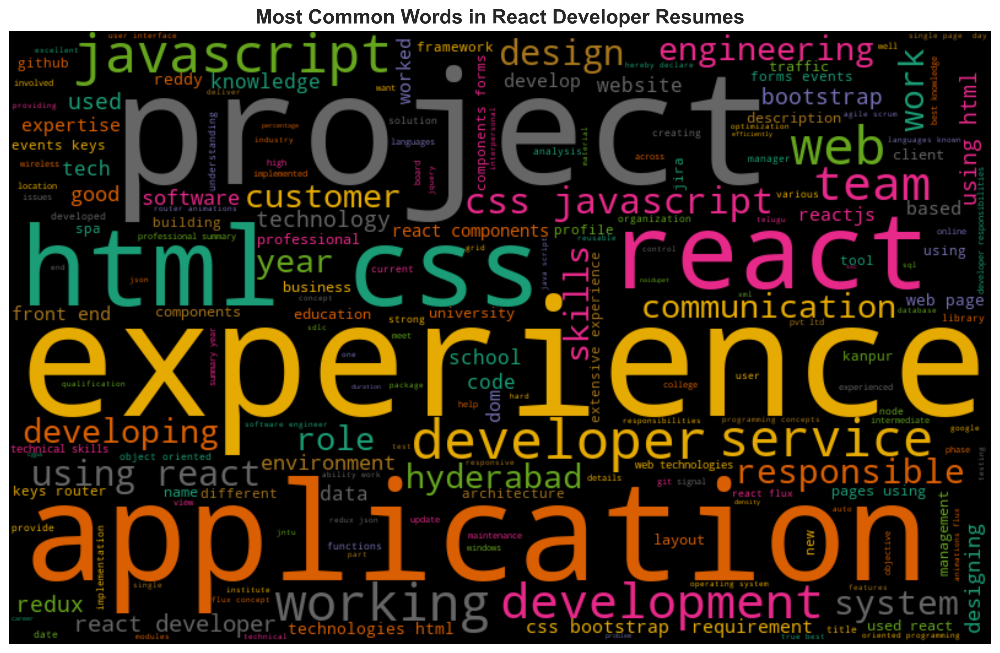

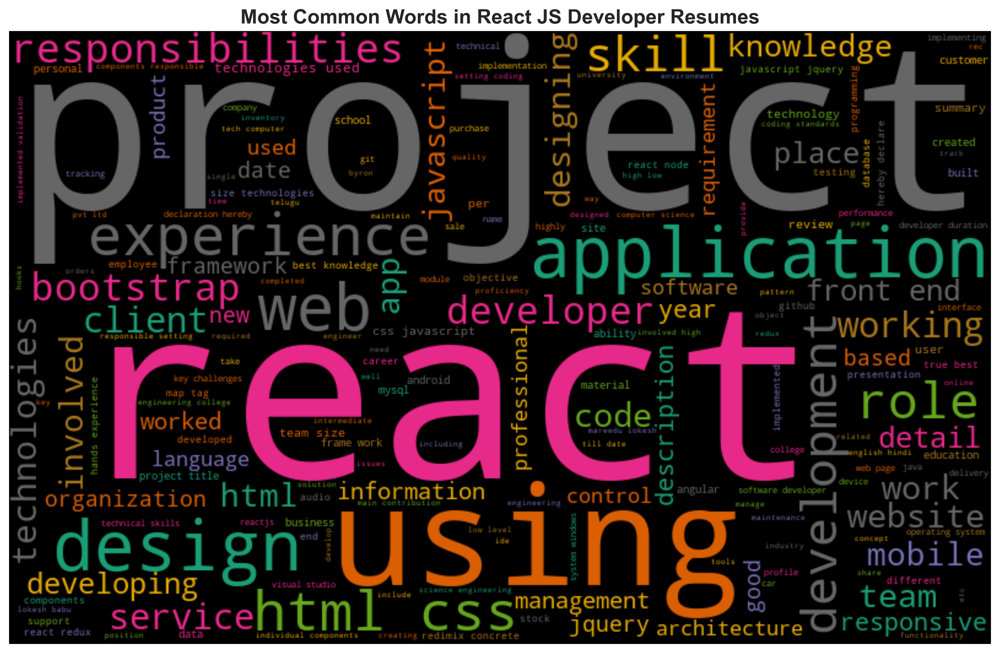

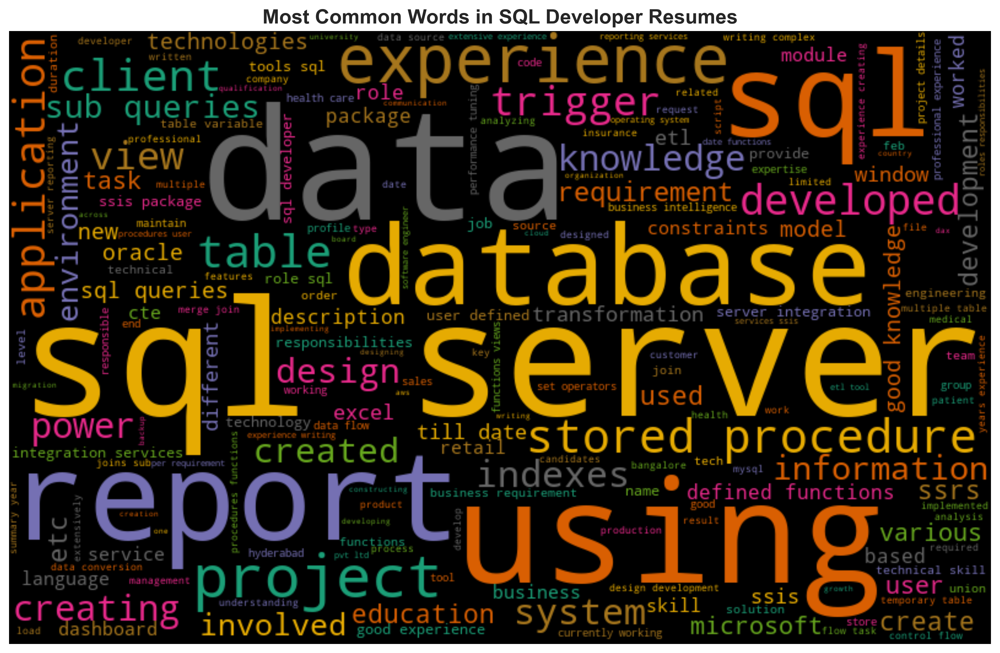

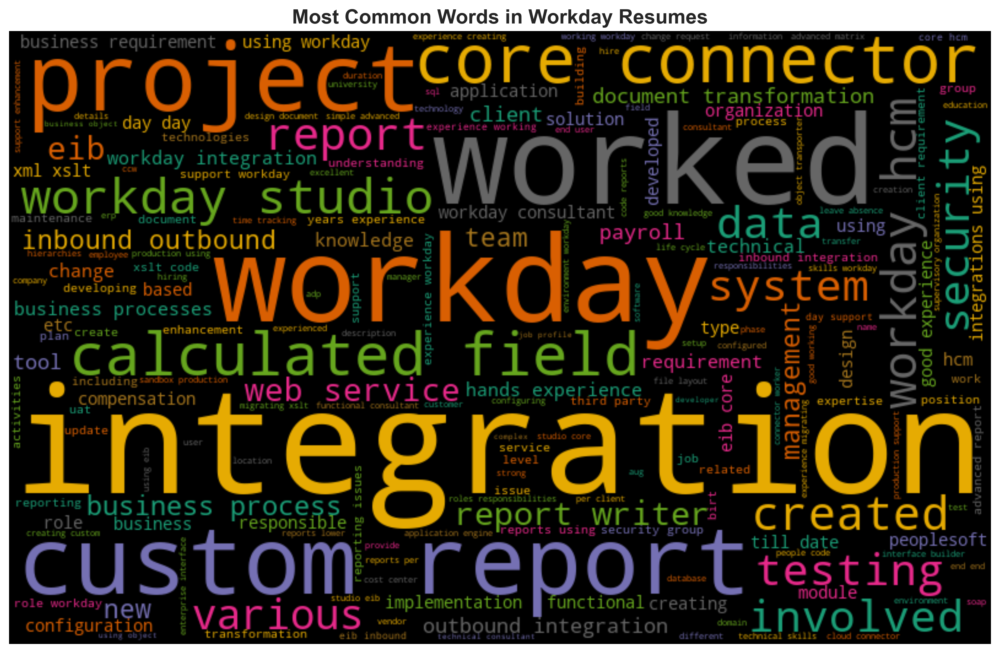

In [93]:
for profiles in df.Profiles.unique():
    all_words = ' '.join([text for text in df['Clean_Resumes'][df.Profiles == profiles]])
    generate_wordcloud(all_words, profiles)

In [3]:
categories = np.sort(df['Profiles'].unique())
categories

array(['Peoplesoft', 'React Developer', 'SQL Developer', 'Workday'],
      dtype=object)

In [4]:
df_categories = [df[df['Profiles'] == category].loc[:, ['Clean_Resumes', 'Profiles']] for category in categories]

In [6]:
def wordfreq(df):
    count = df['Clean_Resumes'].str.split(expand=True).stack().value_counts().reset_index()
    count.columns = ['Word', 'Frequency']

    return count.head(10)

In [7]:
for i, category in enumerate(categories):
    print(category)

Peoplesoft
React Developer
SQL Developer
Workday


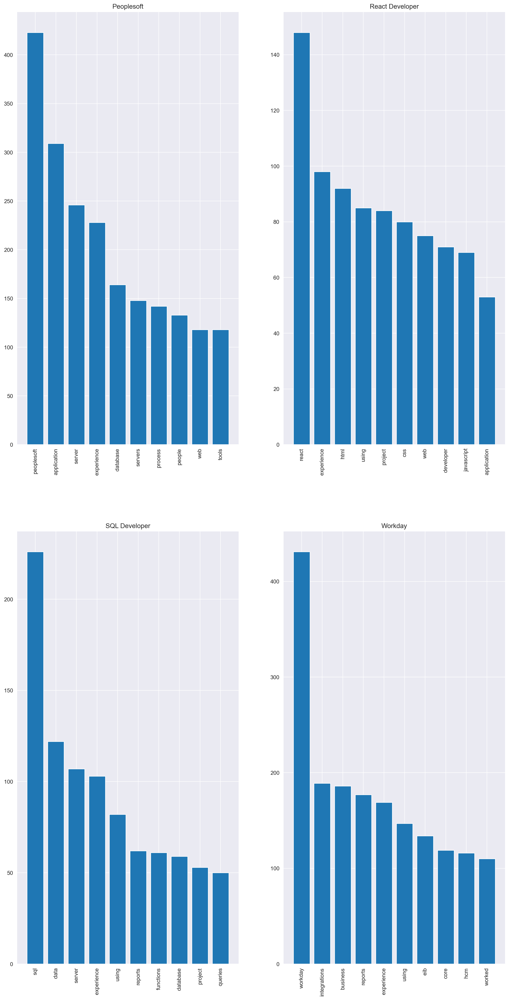

In [8]:
fig = plt.figure(figsize=(16, 32), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(2, 2, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=90)

plt.show()

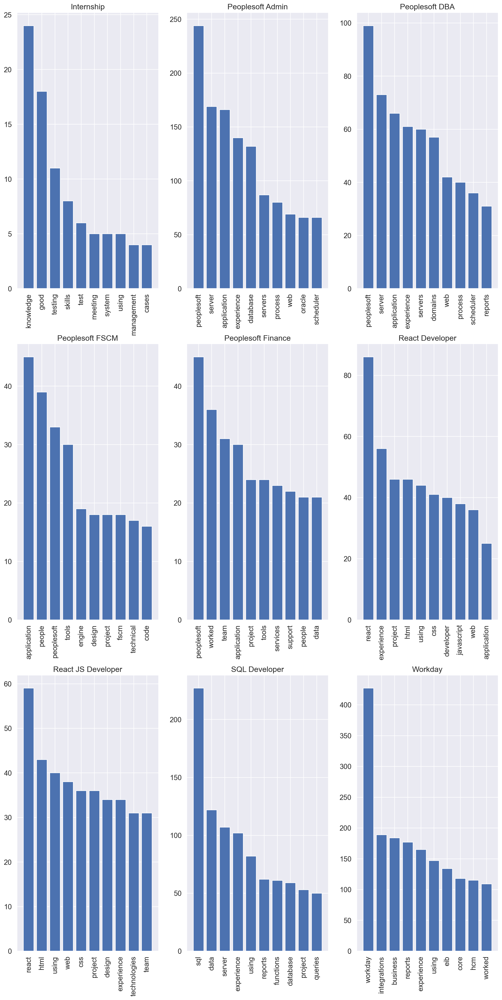

In [113]:
fig = plt.figure(figsize=(16, 32), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(3, 3, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=90)

plt.show()

In [ ]:
fig = plt.figure(figsize=(22, 64), dpi=200)

for i, category in enumerate(categories):
    wf = wordfreq(df_categories[i])

    fig.add_subplot(3, 3, i + 1).set_title(category)
    plt.bar(wf['Word'], wf['Frequency'])
    plt.xticks(rotation=45)

plt.show()

### <a id='6Da'> Named Entity Recognition (NER)</a>

In [85]:
# Parts Of Speech (POS) Tagging
nlp=spacy.load('en_core_web_lg')

one_block=cleanedSentences[:2000]
doc_block=nlp(one_block)
spacy.displacy.render(doc_block,style='ent',jupyter=True)

In [80]:
for token in doc_block[:50]:
    print(token,token.pos_)  

name NOUN
ravali NOUN
curriculum NOUN
vitae NOUN
specialization NOUN
computer NOUN
science NOUN
engg NOUN
careerobjective ADJ
utilize VERB
technical ADJ
skills NOUN
achieving VERB
target NOUN
developing VERB
best ADJ
performance NOUN
organization NOUN
education NOUN
degree NOUN
course NOUN
college NOUN
institute NOUN
university NOUN
board NOUN
percentage NOUN
cgpa NOUN
year NOUN
passing VERB
institute NOUN
technology NOUN
vtu VERB
cgpacgpa NOUN
cgpa NOUN
diploma NOUN
aryabharathi ADP
polytechnic ADJ
karnataka NOUN
state NOUN
board NOUN
technical ADJ
examination NOUN
bengaluru NOUN
sslc ADJ
empress ADJ
girls NOUN
high ADJ
school NOUN
karnataka NOUN
secondary ADJ


#### Filtering out only the nouns and verbs from the Text to Tokens

In [81]:
# Filtering the nouns and verbs only
one_block=cleanedSentences
doc_block=nlp(one_block)
nouns_verbs=[token.text for token in doc_block if token.pos_ in ('NOUN','VERB')]
print(nouns_verbs[100:200])

['meeting', 'knowledge', 'sprint', 'meeting', 'knowledge', 'product', 'backlog', 'meeting', 'bug', 'triage', 'meeting', 'knowledge', 'normalization', 'skills', 'knowledge', 'method', 'overloading', 'method', 'overriding', 'understanding', 'understanding', 'variables', 'knowledge', 'constructor', 'knowledge', 'abstraction', 'knowledge', 'encapsulation', 'knowledge', 'inheritance', 'knowledge', 'collections', 'projects', 'projects', 'year', 'completion', 'farmland', 'crop', 'prevention', 'animal', 'intrusion', 'detection', 'using', 'cnn', 'library', 'management', 'system', 'training', 'courses', 'training', 'course', 'conducted', 'duration', 'internship', 'zerozilla', 'month', 'exposure', 'industry', 'skills', 'learned', 'zerozilla', 'software', 'company', 'bengaluru', 'webtechnology', 'php', 'sql', 'stack', 'achievements', 'level', 'certified', 'cyber', 'security', 'training', 'sjbit', 'bengaluru', 'certified', 'volleyball', 'olympics', 'distict', 'assignements', 'identified', 'test', '

#### Counting all the nouns and verbs present in the Tokens of words

In [82]:
# Counting the noun & verb tokens
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()

X=cv.fit_transform(nouns_verbs)
sum_words=X.sum(axis=0)

words_freq=[(word,sum_words[0,idx]) for word,idx in cv.vocabulary_.items()]
words_freq=sorted(words_freq, key=lambda x: x[1], reverse=True)

wd_df=pd.DataFrame(words_freq)
wd_df.columns=['word','count']
wd_df[0:10] # viewing top ten results

,word,count
0,experience,582
1,workday,423
2,application,415
3,using,394
4,server,358
5,data,331
6,reports,326
7,project,323
8,business,270
9,web,248


#### Visualizing the Result of Top 10 nouns and verbs most frequently present in the Resumes

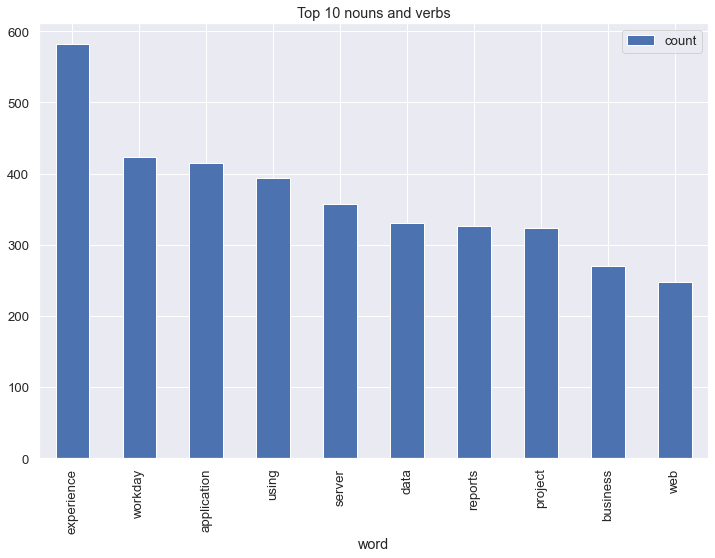

In [84]:
# Visualizing results (Barchart for top 10 nouns + verbs)
wd_df[0:10].plot.bar(x='word',figsize=(12,8),title='Top 10 nouns and verbs')
plt.show()

### <a id='6'> Basic Feature Extaction</a>

#### <a id='6Aa'> **Applying bag of Words without N grams**</a>

In [49]:
from sklearn.feature_extraction.text import CountVectorizer
cv=CountVectorizer()
tweetscv=cv.fit_transform(requiredWords)

In [51]:
print(cv.vocabulary_)

{'vinay': 258, 'kumar': 122, 'workday': 263, 'functional': 94, 'consultant': 41, 'expertisesummary': 88, 'years': 272, 'total': 240, 'experience': 86, 'knowledge': 121, 'modules': 145, 'core': 44, 'hcm': 101, 'supervisory': 222, 'organization': 159, 'delegation': 59, 'cost': 45, 'center': 20, 'locations': 130, 'security': 208, 'implementing': 106, 'integrations': 112, 'various': 256, 'including': 108, 'compensation': 30, 'time': 238, 'tracking': 243, 'absence': 1, 'management': 135, 'payroll': 166, 'benefits': 12, 'performance': 171, 'good': 97, 'groups': 99, 'role': 199, 'based': 11, 'user': 252, 'job': 119, 'experienced': 87, 'report': 190, 'writing': 269, 'custom': 49, 'reports': 192, 'simple': 213, 'advanced': 5, 'matrix': 138, 'composite': 33, 'calculated': 18, 'fields': 91, 'eib': 72, 'connectors': 40, 'xml': 270, 'xslt': 271, 'web': 259, 'services': 211, 'structure': 219, 'objects': 154, 'hands': 100, 'migrating': 142, 'code': 26, 'lower': 131, 'tenant': 234, 'sandbox': 203, 'pr

In [52]:
print(cv.get_feature_names()[109:200])

['independent', 'information', 'integration', 'integrations', 'interface', 'interfaces', 'internal', 'interpersonal', 'involved', 'issues', 'job', 'keys', 'knowledge', 'kumar', 'languages', 'layout', 'leadership', 'legacy', 'like', 'loading', 'location', 'locations', 'lower', 'mahindra', 'maintain', 'managed', 'management', 'mass', 'master', 'matrix', 'members', 'menus', 'microsoft', 'migrating', 'modifications', 'modified', 'modules', 'monitor', 'monitored', 'moving', 'multiple', 'narayana', 'needed', 'new', 'object', 'objects', 'objecttransporter', 'one', 'online', 'order', 'organization', 'organizations', 'outbound', 'output', 'ownership', 'pages', 'payments', 'payroll', 'people', 'peoplesoft', 'per', 'perform', 'performance', 'performing', 'personal', 'player', 'powerpoint', 'process', 'processes', 'processing', 'production', 'professionalsummary', 'project', 'prompt', 'publisher', 'queries', 'query', 'ran', 'ready', 'records', 'relationships', 'report', 'reporting', 'reports', 're

In [53]:
print(cv.get_feature_names()[:100])

['ability', 'absence', 'account', 'activity', 'administration', 'advanced', 'allowances', 'analyst', 'application', 'assign', 'bank', 'based', 'benefits', 'best', 'building', 'built', 'bulk', 'business', 'calculated', 'calls', 'center', 'challenge', 'change', 'changes', 'clarifications', 'client', 'code', 'college', 'communication', 'company', 'compensation', 'component', 'components', 'composite', 'concepts', 'configurable', 'configure', 'configured', 'configuring', 'connector', 'connectors', 'consultant', 'contacts', 'conversions', 'core', 'cost', 'created', 'csv', 'current', 'custom', 'customers', 'customized', 'daily', 'data', 'date', 'day', 'declaration', 'declare', 'definition', 'delegation', 'delivered', 'design', 'designation', 'designed', 'develop', 'developed', 'development', 'different', 'document', 'documents', 'edits', 'educationsummary', 'eib', 'eibs', 'emergency', 'employees', 'enable', 'engine', 'engineering', 'engines', 'enhancements', 'errors', 'etc', 'excel', 'excell

In [65]:
print(tweetscv.toarray()[100:200])

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


### <a id='6Ba'>**CountVectorizer with N-grams (Bigrams & Trigrams)**</a>

In [3]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

  0%|          | 0/79 [00:00<?, ?it/s]

In [28]:
df.Clean_Resumes[7]

'profile summary overall years experience peoplesoft administrator installed peopletools scratch including products experience peopletools application hrms fscm deterministic approach towards problem solving troubleshooting proficient integration broker upgraded fscm hcm applications peopletools peopletools education graduated tech electronics communication engg college engineering vizianagaram jntuk aggregate achieved marksinthstandard scored inthstandard achievements awarded bravo pat back techahindra awarded associate month award innovator month time awarded spot pat back capgemini work experience capgemini may till production support finance environment respective non production environments project experience project name axa role consultant environment windows server cognizant technol ogy sol ions augus april voya financial insurance client project deals support managing finance applications project experience project name voya financials role associate environment windows server

In [29]:
corpus[7]

'profil summari overal year experi peoplesoft administr instal peopletool scratch includ product experi peopletool applic hrm fscm determinist approach toward problem solv troubleshoot profici integr broker upgrad fscm hcm applic peopletool peopletool educ graduat tech electron commun engg colleg engin vizianagaram jntuk aggreg achiev marksinthstandard score inthstandard achiev award bravo pat back techahindra award associ month award innov month time award spot pat back capgemini work experi capgemini may till product support financ environ respect non product environ project experi project name axa role consult environ window server cogniz technol ogi sol ion augu april voya financi insur client project deal support manag financ applic project experi project name voya financi role associ environ window server tech mahindra limit juli augu peoplesoft implement fin applic peoplesoft implement project includ peoplesoft applic interfac third parti applic interfac live product peoplesoft 

In [59]:
## Applying Countvectorizer
# Creating the Bag of Words model
cv = CountVectorizer(max_features=5000,ngram_range=(1,3))
X = cv.fit_transform(corpus).toarray()

In [60]:
X.shape

(79, 5000)

In [61]:
cv.get_feature_names()[:20]

['abil',
 'abil work',
 'abil work team',
 'absenc',
 'absenc manag',
 'academ',
 'accentur',
 'accept',
 'accept level',
 'accept level statu',
 'accept test',
 'access',
 'access peopl',
 'access peopl book',
 'accord',
 'accord chang',
 'accord chang request',
 'accord client',
 'account',
 'account inform']

In [62]:
cv.get_params()

{'analyzer': 'word',
 'binary': False,
 'decode_error': 'strict',
 'dtype': numpy.int64,
 'encoding': 'utf-8',
 'input': 'content',
 'lowercase': True,
 'max_df': 1.0,
 'max_features': 5000,
 'min_df': 1,
 'ngram_range': (1, 3),
 'preprocessor': None,
 'stop_words': None,
 'strip_accents': None,
 'token_pattern': '(?u)\\b\\w\\w+\\b',
 'tokenizer': None,
 'vocabulary': None}

In [63]:
count_df = pd.DataFrame(X, columns=cv.get_feature_names())
count_df

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74,1,1,1,2,1,0,0,1,0,0,...,0,0,0,0,0,0,0,1,1,1
75,1,0,0,7,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
76,0,0,0,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
77,1,0,0,2,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### <a id='6Ca'> **TF-IDF Vectorizer**</a>

In [75]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

  0%|          | 0/77 [00:00<?, ?it/s]

In [4]:
corpus[1]

'susovan bag seek challeng posit field scienc technolog util skill organ individu growth enhanc knowledg academ learn give best organ skill ccna rout switch subnet program java html css sql oop algorithm data structur dbm network linux linux system administr troubleshoot soft skill leadership collabor good commun custom handl skill languag english fluent hindi fluent bengali nativ telugu project smart agricultur built product farmer use iot solut automat water motor control iot android api technolog combin autom work water motor control use sensor bookstor manag interfac manag purchas return book book store hotel manag system dec design front end modul hotel manag system websit use html css onlin movi ticket book design fulli function websit use html css javascript educ background love profession univers punjab india tech comput scienc engin gpa sri chaitanya junior colleg visakhapatnam india intermedi mpc intermedi mr mariada school ics hobbi web surf cricket carrom chess'

In [76]:
## TFidf Vectorizer
tfidf_v=TfidfVectorizer(max_features=5000,ngram_range=(1,3))
X=tfidf_v.fit_transform(corpus).toarray()

In [77]:
X.shape

(77, 5000)

In [7]:
tfidf_v.get_feature_names()[:20]

['abil',
 'abil work',
 'abil work team',
 'absenc',
 'absenc manag',
 'academ',
 'accentur',
 'accept',
 'accept level',
 'accept level statu',
 'accept test',
 'access',
 'access peopl',
 'access peopl book',
 'accord',
 'accord chang',
 'accord chang request',
 'accord client',
 'account',
 'account inform']

In [9]:
tfidf_v.get_feature_names()[4980:]

['xslt present',
 'xslt present data',
 'xtt',
 'xtt function',
 'year',
 'year experi',
 'year experi develop',
 'year experi peoplesoft',
 'year experi react',
 'year experi softwar',
 'year experi workday',
 'year extens',
 'year extens experi',
 'year industri',
 'year industri role',
 'year month',
 'year pass',
 'year profession',
 'year profession experi',
 'year workday']

In [10]:
tfidf_v.get_params()

{'analyzer': 'word',
 'binary': False,
 'decode_error': 'strict',
 'dtype': numpy.float64,
 'encoding': 'utf-8',
 'input': 'content',
 'lowercase': True,
 'max_df': 1.0,
 'max_features': 5000,
 'min_df': 1,
 'ngram_range': (1, 3),
 'norm': 'l2',
 'preprocessor': None,
 'smooth_idf': True,
 'stop_words': None,
 'strip_accents': None,
 'sublinear_tf': False,
 'token_pattern': '(?u)\\b\\w\\w+\\b',
 'tokenizer': None,
 'use_idf': True,
 'vocabulary': None}

In [78]:
tfidf_df = pd.DataFrame(X, columns=tfidf_v.get_feature_names())
tfidf_df

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,0.012073,0.016910,0.021776,0.036670,0.021776,0.0,0.0,0.018891,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.021776,0.02276,0.021776
73,0.013670,0.000000,0.000000,0.145323,0.000000,0.0,0.0,0.021389,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.024657
74,0.000000,0.000000,0.000000,0.015370,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.016345,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000
75,0.013339,0.000000,0.000000,0.040517,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.000000


In [3]:
from nltk.corpus import stopwords
ps = PorterStemmer()
corpus = []
for i in tqdm_notebook(range(0, len(df))):
    review = re.sub('[^a-zA-Z]', ' ', df['Clean_Resumes'][i])
    review = review.lower()
    review = review.split()
    
    review = [ps.stem(word) for word in review if not word in stopwords.words('english')]
    review = ' '.join(review)
    corpus.append(review)

# requiredText = df['Clean_Resumes'].values

word_vectorizer = TfidfVectorizer(
    sublinear_tf=True,
    stop_words='english',
    max_features=5000,
    ngram_range=(1,3))
tfidf=word_vectorizer.fit(corpus)
WordFeatures = word_vectorizer.transform(corpus).toarray()

tfidf_df = pd.DataFrame(WordFeatures, columns=tfidf.get_feature_names())
tfidf_df

  0%|          | 0/77 [00:00<?, ?it/s]

,abil,abil work,abil work team,absenc,absenc manag,academ,accentur,accept,accept level,accept level statu,...,year experi workday,year extens,year extens experi,year industri,year industri role,year month,year pass,year profession,year profession experi,year workday
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,0.019378,0.027142,0.034952,0.049828,0.034952,0.0,0.0,0.030321,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.034952,0.036532,0.034952
73,0.021592,0.000000,0.000000,0.096600,0.000000,0.0,0.0,0.033785,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.038945
74,0.000000,0.000000,0.000000,0.024153,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.025686,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
75,0.020138,0.000000,0.000000,0.051782,0.000000,0.0,0.0,0.000000,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000


In [45]:
tfidf_df.to_csv('tfidf.csv', index = False)

In [46]:
import pickle

pickle.dump(tfidf, open("tfidf.pkl", "wb"))

## <a id='7'> Feature Extraction</a>

We need to convert textual representation in the form on numeric features. We have two popular techniques to perform feature extraction:

1. __Bag of words (Simple vectorization)__
2. __TF-IDF (Term Frequency - Inverse Document Frequency)__

We will use extracted features from both one by one to perform sentiment analysis and will compare the result at last.


### <a id='7Aa'>A. Feature Extraction for 'Key Words'</a>

In [86]:
# BOW features
bow_word_vectorizer = CountVectorizer(max_df=0.90, min_df=2, stop_words='english')
# bag-of-words feature matrix
bow_word_feature = bow_word_vectorizer.fit_transform(df['Clean_Resumes'])

# TF-IDF features
tfidf_word_vectorizer = TfidfVectorizer(max_df=0.90, min_df=2, stop_words='english')
# TF-IDF feature matrix
tfidf_word_feature = tfidf_word_vectorizer.fit_transform(df['Clean_Resumes'])